# Regression Analysis on Weather Data
### by: Amir Nejad ,PhD.

In this notebook I am going to attempt to perform a bivariate regression analysis on weather  [data](https://www.kaggle.com/budincsevity/szeged-weather). Dataset contains the basic weather readings like temperature, wind speed, pressure, and weather condition.  

The goal is to build a regression model to predict Temperature data from Humidity.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly_express as px
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn import linear_model

In [2]:
data=pd.read_csv('weatherHistory.csv')

### 1) Data Exploration
Let’s first explore the data and gain as much insight about the data before doing any analysis.
This dataset has 12 columns with 96,453 rows of data.As it can be seen in the following two lines of code, dataset contains both numeric and categorical data.

In [3]:
data.head()

,Formatted Date,Summary,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Loud Cover,Pressure (millibars),Daily Summary
0,2006-04-01 00:00:00.000 +0200,Partly Cloudy,rain,9.472222,7.388889,0.89,14.1197,251.0,15.8263,0.0,1015.13,Partly cloudy throughout the day.
1,2006-04-01 01:00:00.000 +0200,Partly Cloudy,rain,9.355556,7.227778,0.86,14.2646,259.0,15.8263,0.0,1015.63,Partly cloudy throughout the day.
2,2006-04-01 02:00:00.000 +0200,Mostly Cloudy,rain,9.377778,9.377778,0.89,3.9284,204.0,14.9569,0.0,1015.94,Partly cloudy throughout the day.
3,2006-04-01 03:00:00.000 +0200,Partly Cloudy,rain,8.288889,5.944444,0.83,14.1036,269.0,15.8263,0.0,1016.41,Partly cloudy throughout the day.
4,2006-04-01 04:00:00.000 +0200,Mostly Cloudy,rain,8.755556,6.977778,0.83,11.0446,259.0,15.8263,0.0,1016.51,Partly cloudy throughout the day.


In [4]:
data.shape

(96453, 12)

Some columns contain no data such as Loud Cover and it should be removed from dataset however since I am only going to use Humidity and temperature data I am going to ignore it for now.

In [5]:
data.describe()

,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Loud Cover,Pressure (millibars)
count,96453.000000,96453.000000,96453.000000,96453.000000,96453.000000,96453.000000,96453.0,96453.000000
mean,11.932678,10.855029,0.734899,10.810640,187.509232,10.347325,0.0,1003.235956
std,9.551546,10.696847,0.195473,6.913571,107.383428,4.192123,0.0,116.969906
min,-21.822222,-27.716667,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
25%,4.688889,2.311111,0.600000,5.828200,116.000000,8.339800,0.0,1011.900000
50%,12.000000,12.000000,0.780000,9.965900,180.000000,10.046400,0.0,1016.450000
75%,18.838889,18.838889,0.890000,14.135800,290.000000,14.812000,0.0,1021.090000
max,39.905556,39.344444,1.000000,63.852600,359.000000,16.100000,0.0,1046.380000


The next step is to check for null cells and If any row contains null we have to drop the row.

In [6]:
data.isna().any()

Formatted Date              False
Summary                     False
Precip Type                  True
Temperature (C)             False
Apparent Temperature (C)    False
Humidity                    False
Wind Speed (km/h)           False
Wind Bearing (degrees)      False
Visibility (km)             False
Loud Cover                  False
Pressure (millibars)        False
Daily Summary               False
dtype: bool

In [7]:
data=data.dropna()

In [8]:
list(data)


['Formatted Date',
 'Summary',
 'Precip Type',
 'Temperature (C)',
 'Apparent Temperature (C)',
 'Humidity',
 'Wind Speed (km/h)',
 'Wind Bearing (degrees)',
 'Visibility (km)',
 'Loud Cover',
 'Pressure (millibars)',
 'Daily Summary']

Scatterplot Matrix is good way of exploring high dimensional data. Here I am using plotly_express package to create interactive plots. However this can be replicated with other packages such as seaborn. 

In [9]:
px.scatter_matrix(data, dimensions=['Temperature (C)'
                                    , 'Humidity'
                                    , 'Wind Speed (km/h)'
                                    , 'Pressure (millibars)'], color='Precip Type')

One observation can be infered here that pressure data contains lot of zero values which are physically impossible therefore, zero values can be treated as muissing data and should be removed if Pressure data is used in modeling.

### 2) Regression Modeling
In this section we are going to build a regression model that predicts Temperature from humidity data.
Before performing any modeling, it is a good practice to check for collinearity and correlation between the features. This can be done with heatmap of correlations as demonstrated below.

In [10]:
modeling_data=data.copy()
modeling_data=modeling_data.drop(['Daily Summary','Loud Cover'], axis=1)
le = LabelEncoder()
modeling_data['Summary']=le.fit(modeling_data['Summary']).transform(modeling_data['Summary'])
le2 = LabelEncoder()
modeling_data['Precip Type']=le2.fit(modeling_data['Precip Type']).transform(modeling_data['Precip Type'])

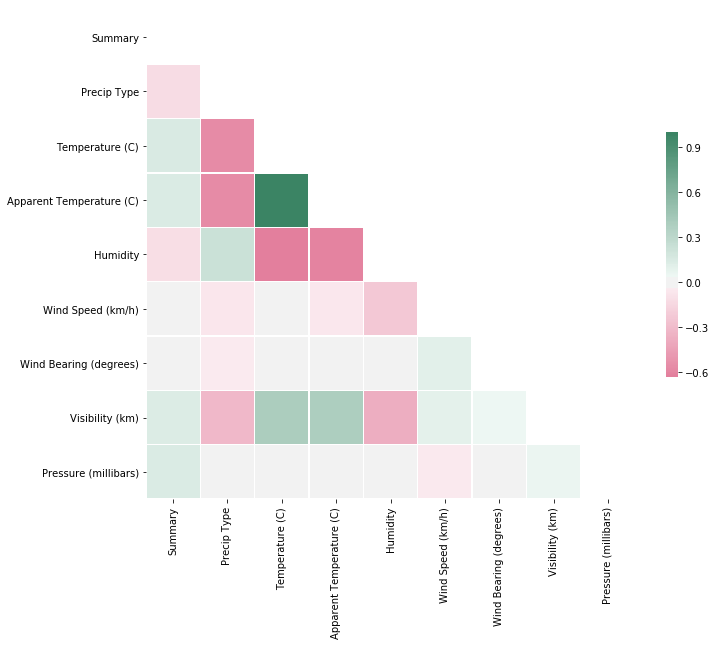

In [11]:
corr = modeling_data.corr()
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(0, 150, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap,  center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

Several observations can be inferred from correlation heatmap analysis:
* Temperature and Apparent Temperature data have similar data since the correlation between them are so high
* Pressure data has a very poor correlation to temperature data and this can be because of existence of rows with zero pressure readings
* Temperature and humidity have inverse correlation

In [12]:
modeling_data=modeling_data.drop(['Apparent Temperature (C)','Formatted Date','Summary',],axis=1)
modeling_data=modeling_data[modeling_data['Humidity']>0]

Now we can attempt to build regression model. I have split the data to train and test data below and fitted linear model obtained from sklearn package.

In [13]:
X_train, X_test, y_train, y_test = train_test_split( modeling_data['Humidity'], 
                                                      modeling_data['Temperature (C)'], 
                                                      test_size=0.33, random_state=42)

In [14]:
reg = linear_model.LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
reg.fit(X_train.values.reshape(-1, 1),y_train.values.reshape(-1, 1))
reg.coef_

array([[-31.09051115]])

In [15]:
print ('In sample regression score: ' + str(reg.score(X_train.values.reshape(-1, 1), y_train.values.reshape(-1, 1))))

In sample regression score: 0.4050498622529831


In [16]:
print ('Out of sample regression score: ' + str(reg.score(X_test.values.reshape(-1, 1), y_test.values.reshape(-1, 1)))) 

Out of sample regression score: 0.40334341633001336


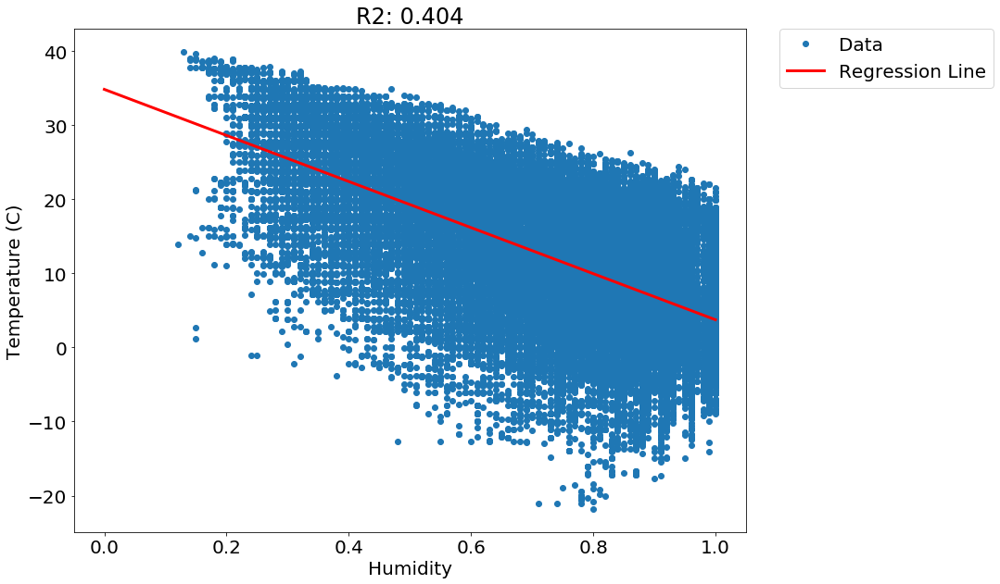

In [17]:
font = {'size'   : 20}
plt.rc('font', **font)
plt.figure(figsize=(13,10))
plt.plot(modeling_data['Humidity'],modeling_data['Temperature (C)'],'o',label='Data')
I=np.linspace(np.floor(min(modeling_data['Humidity'])*0.95),np.ceil(max(modeling_data['Humidity'])*0.11),50)
plt.plot(I,reg.predict(I.reshape(-1, 1)),color='r', linewidth=3,label='Regression Line')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.xlabel('Humidity');plt.ylabel('Temperature (C)')
Preds=reg.predict( modeling_data['Humidity'].values.reshape(-1, 1))
R2=r2_score(modeling_data['Temperature (C)'],Preds )
plt.title('R2: '+ str(np.round(R2,decimals=3)))
plt.show()

Looking at the regression model result above, one should expect the prediction results not to have high accuracy because the relationship between Humidity and Temperature itself is fuzzy since the temperature depends on more parameters than just humidity. In the following section of the code we can see residuals of the regression

In [18]:
Residuals=modeling_data['Temperature (C)'].values.reshape(-1, 1)-Preds

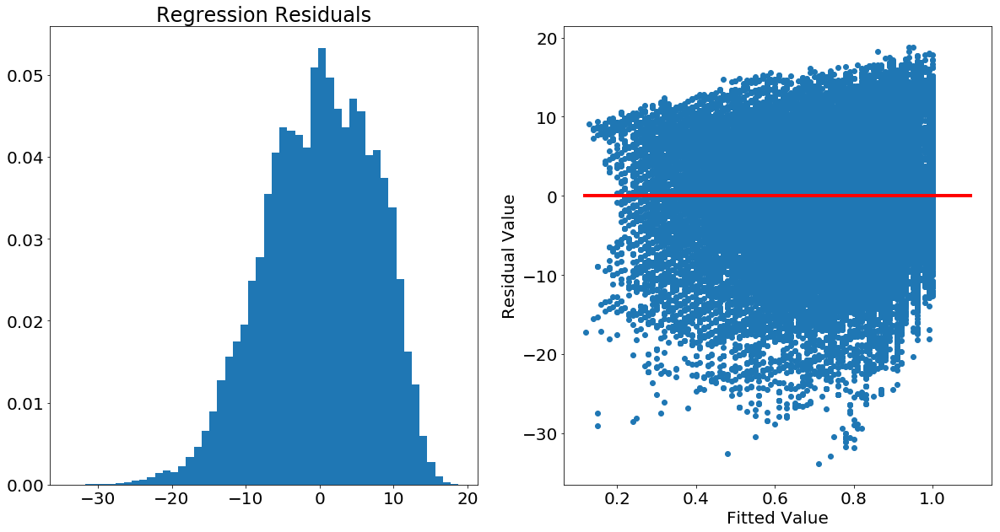

In [19]:
font = {'size'   : 20}
plt.rc('font', **font)
fig, ax = plt.subplots(1,2,figsize=(20,10))
num_bins = 50
n, bins, patches = ax[0].hist(Residuals, num_bins, density=1)
ax[0].title.set_text('Regression Residuals');


ax[1].plot(modeling_data['Humidity'],Residuals,'o')
ax[1].set(xlabel='Fitted Value', ylabel='Residual Value')
ax[1].hlines(0, np.min(modeling_data['Humidity'])*0.95, np.max(modeling_data['Humidity'])*1.1, colors='r', linestyles='solid',zorder=10, linewidth=4 )
plt.show()